# Camera Calibration

Following the tutorial available at https://docs.opencv.org/3.3.1/dc/dbb/tutorial_py_calibration.html

## Setup

In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
#import seaborn as sns

In [2]:
#make matplotlib figures appear inline in the notebook
#rather than in a new window.
%matplotlib inline
#sns.set()
# set default size of plots
plt.rcParams['figure.figsize'] = (12.0, 10.0) 
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'
plt.rcParams['xtick.labelsize'] = 20
plt.rcParams['ytick.labelsize'] = 20


#print OpenCV version
print ("OpenCV Version : %s " % cv2.__version__)

OpenCV Version : 3.3.1 


In [3]:
# the notebook will reload external python modules;
%load_ext autoreload
%autoreload 2

In [4]:
frame_step = 20
#images_path = '../data/calibration_test/'
images_path = '../data/frames_DJI00964/'

## Keypoints detection

In [5]:
# termination criteria
criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)

In [6]:
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
pattern_size = (9,6)
square_size = 1.0
objp = np.zeros((np.prod(pattern_size), 3), np.float32)       
objp[:,:2] = np.indices(pattern_size).T.reshape(-1, 2)
objp *= square_size

../data/frames_DJI00964/frame0.png


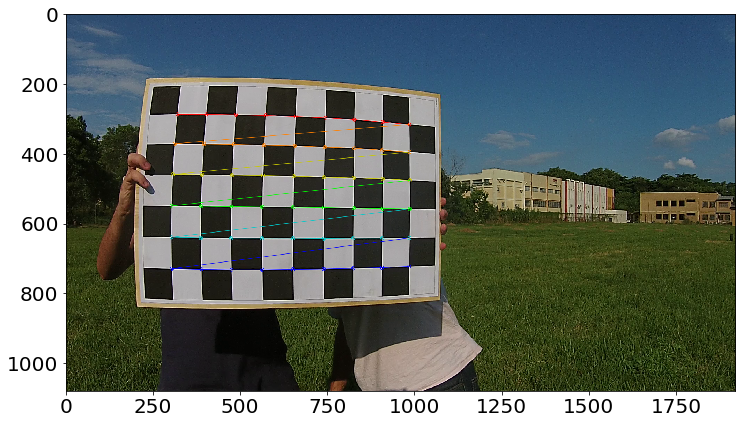

../data/frames_DJI00964/frame20.png


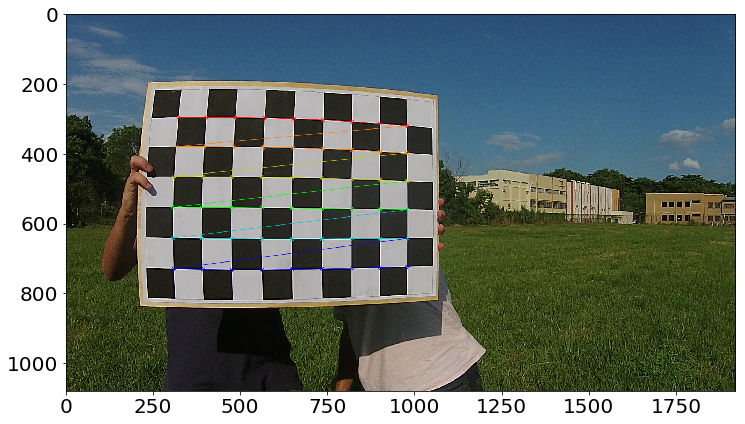

../data/frames_DJI00964/frame40.png


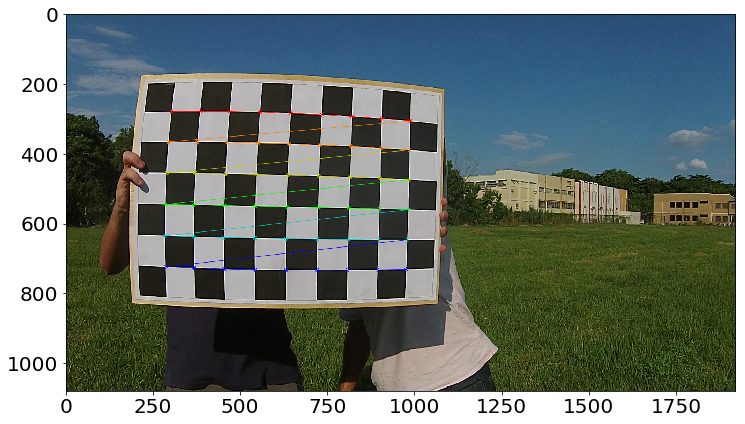

../data/frames_DJI00964/frame60.png


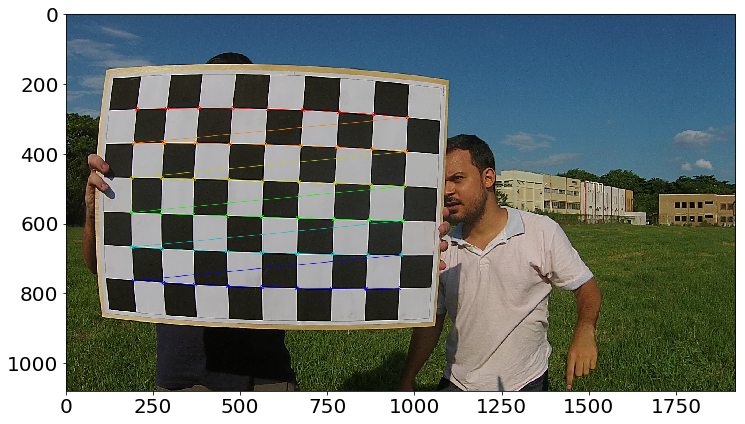

../data/frames_DJI00964/frame80.png


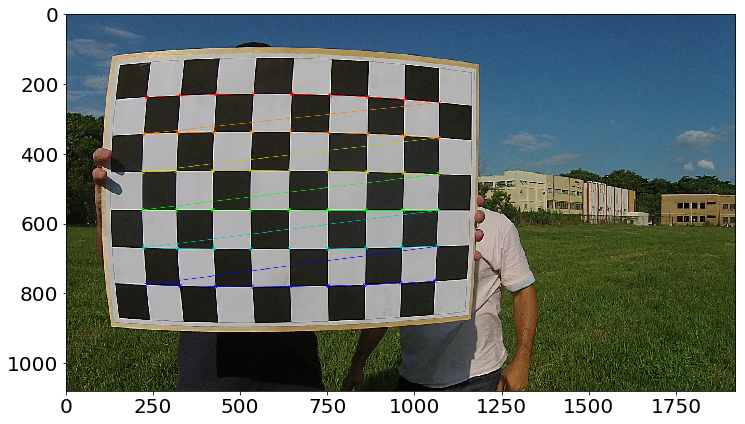

../data/frames_DJI00964/frame100.png


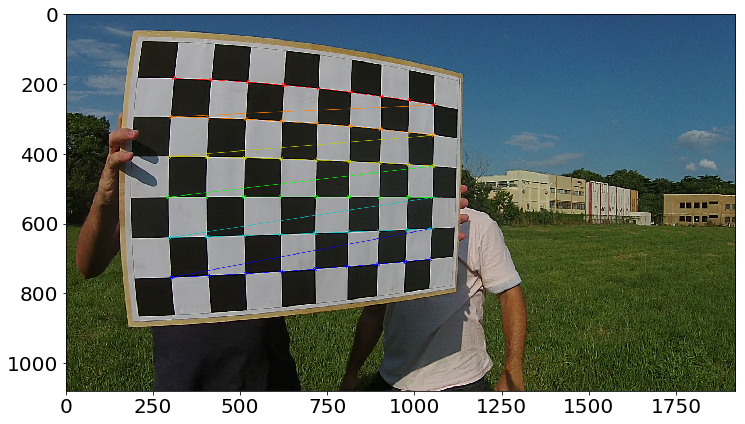

../data/frames_DJI00964/frame120.png


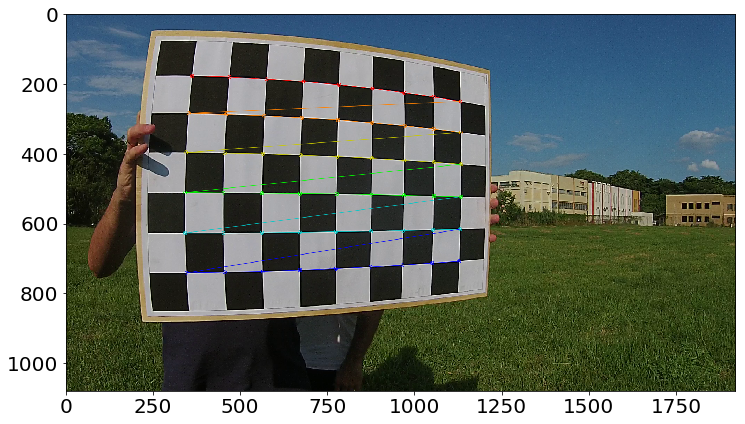

../data/frames_DJI00964/frame140.png


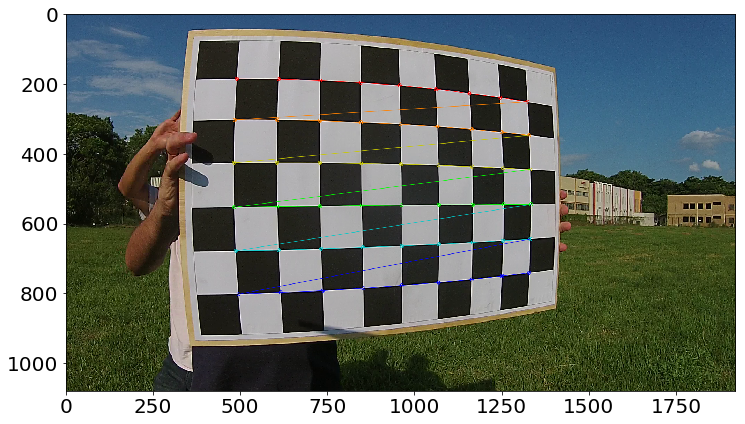

../data/frames_DJI00964/frame160.png


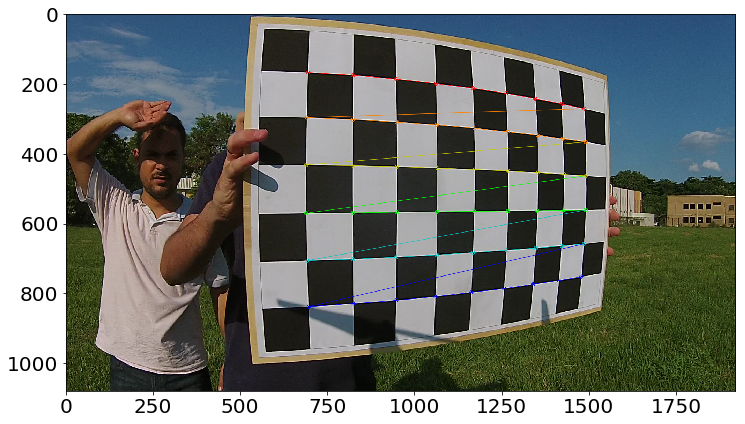

../data/frames_DJI00964/frame180.png


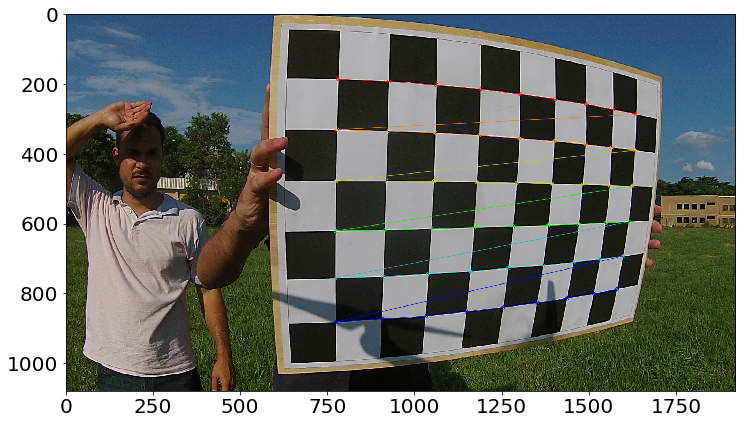

../data/frames_DJI00964/frame200.png


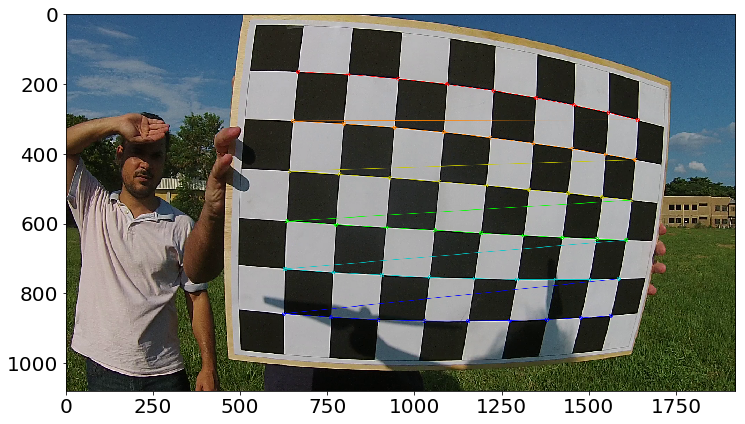

../data/frames_DJI00964/frame220.png


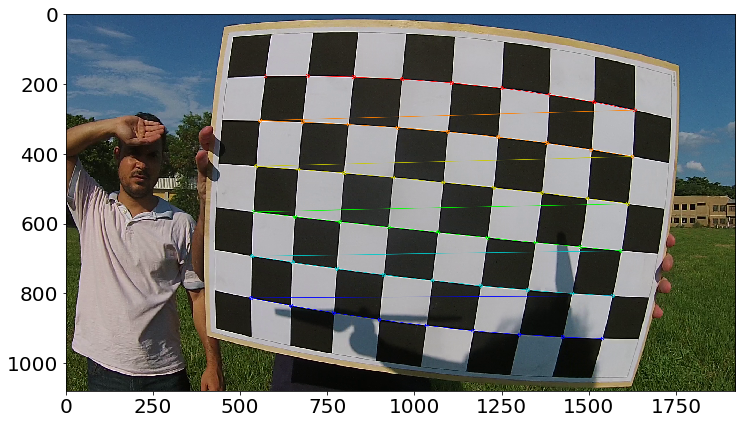

../data/frames_DJI00964/frame240.png


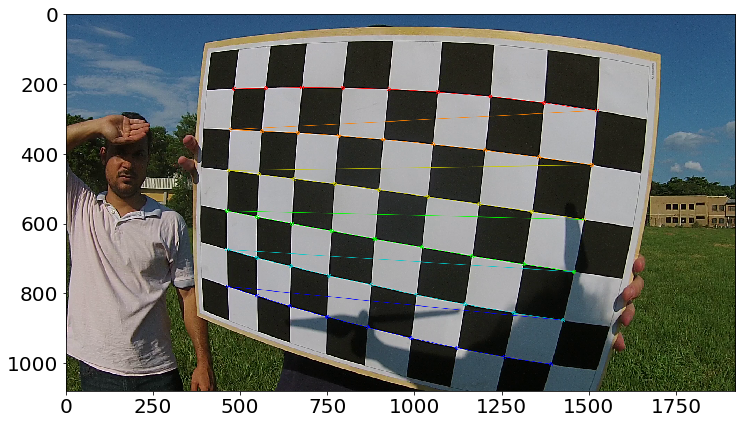

../data/frames_DJI00964/frame260.png


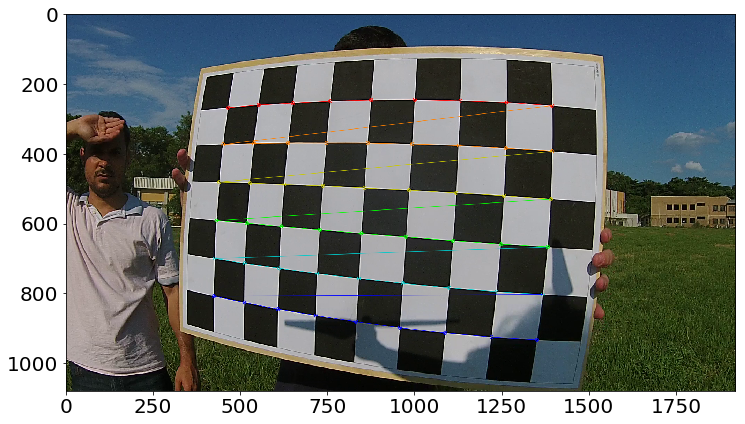

../data/frames_DJI00964/frame280.png


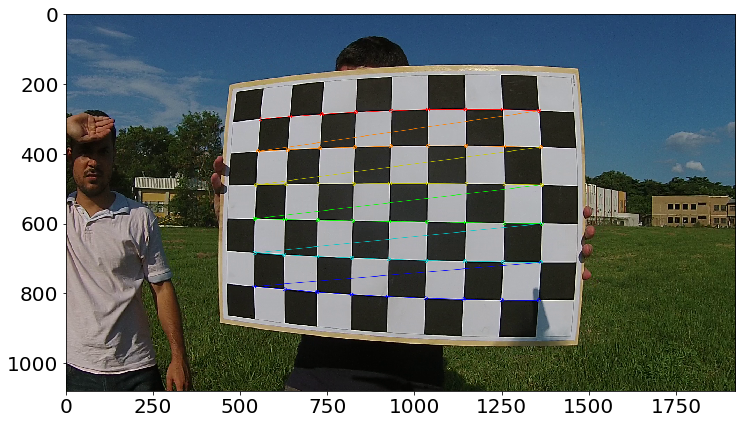

../data/frames_DJI00964/frame300.png


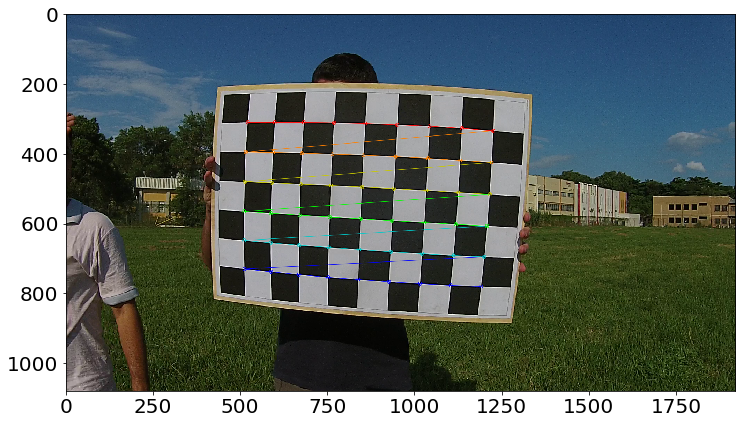

../data/frames_DJI00964/frame320.png


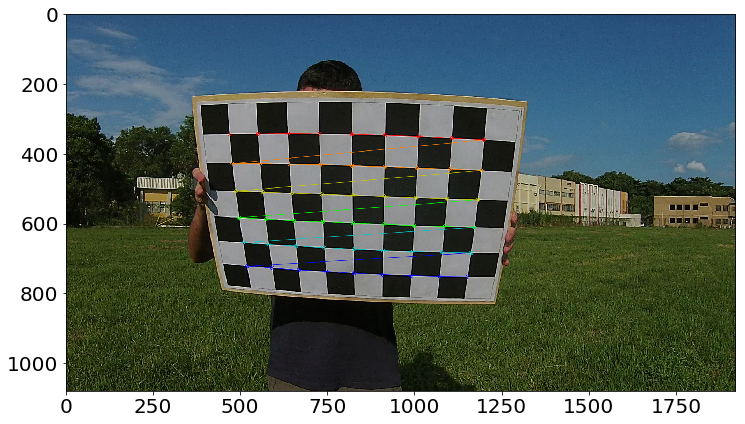

../data/frames_DJI00964/frame340.png


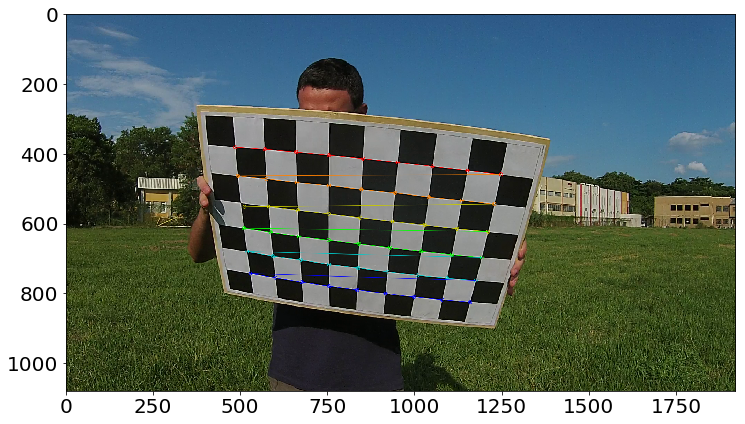

../data/frames_DJI00964/frame360.png


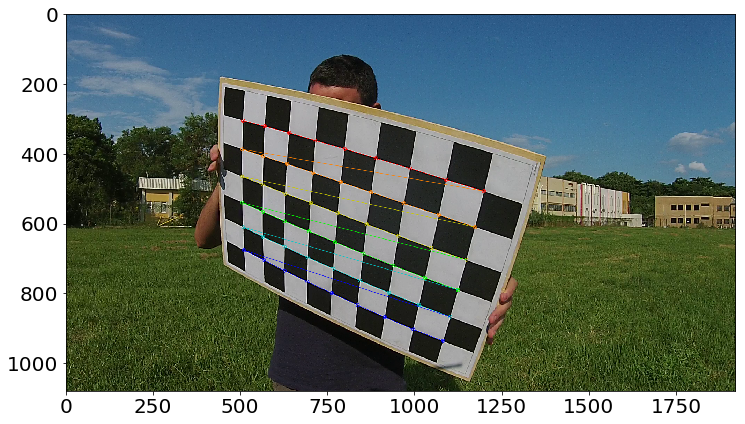

../data/frames_DJI00964/frame380.png


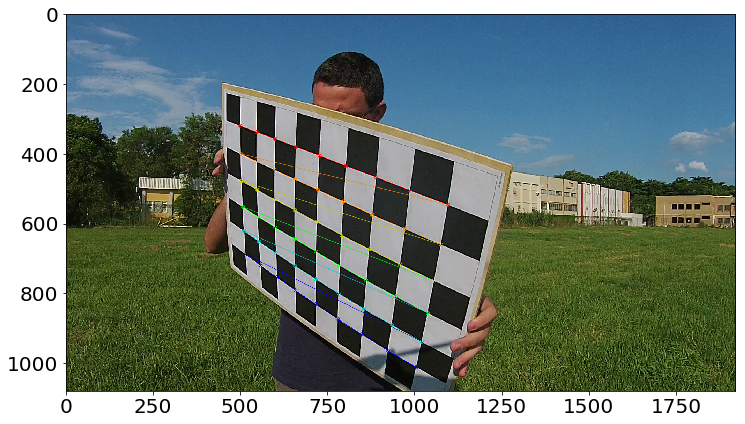

../data/frames_DJI00964/frame400.png


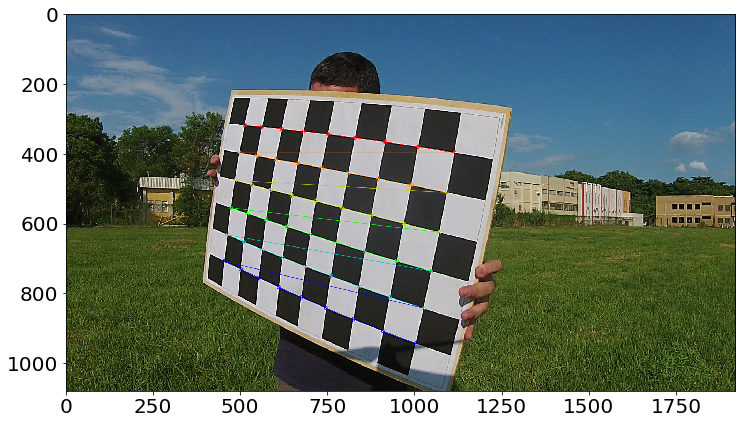

../data/frames_DJI00964/frame420.png


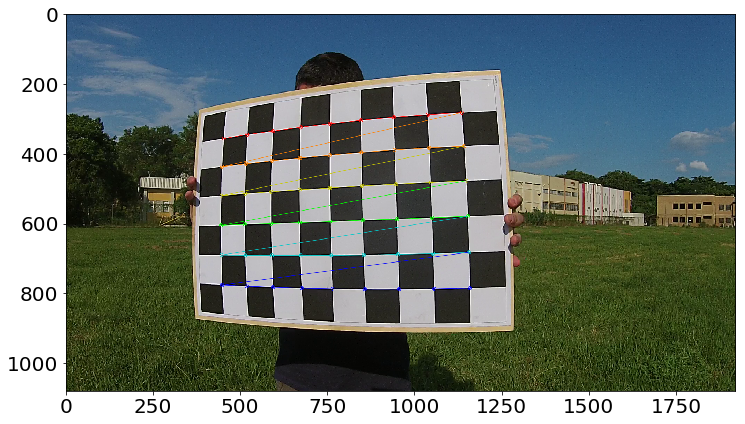

../data/frames_DJI00964/frame440.png


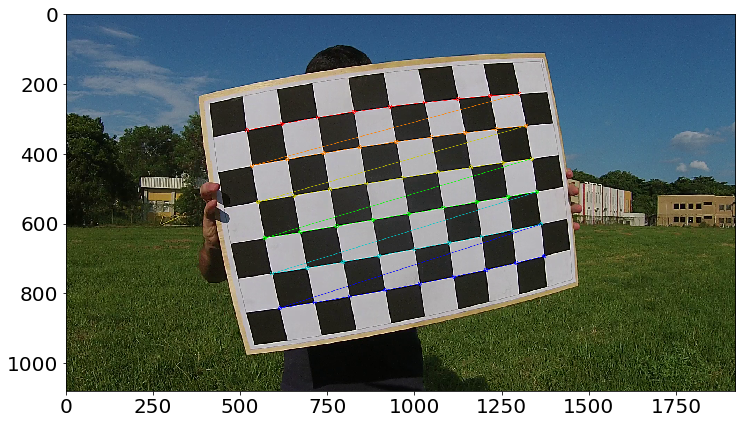

../data/frames_DJI00964/frame460.png


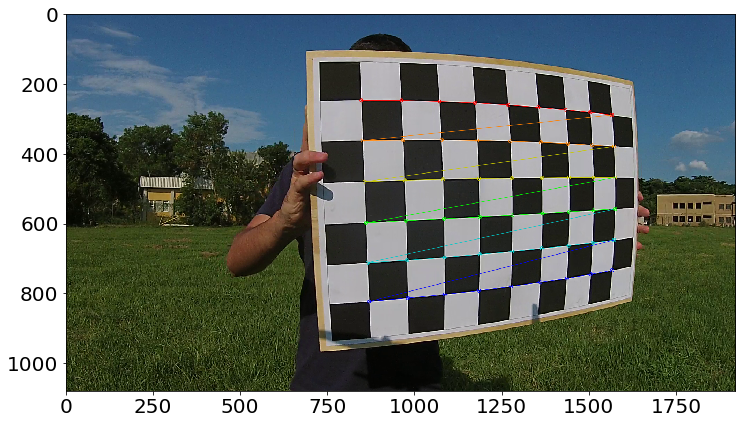

../data/frames_DJI00964/frame480.png


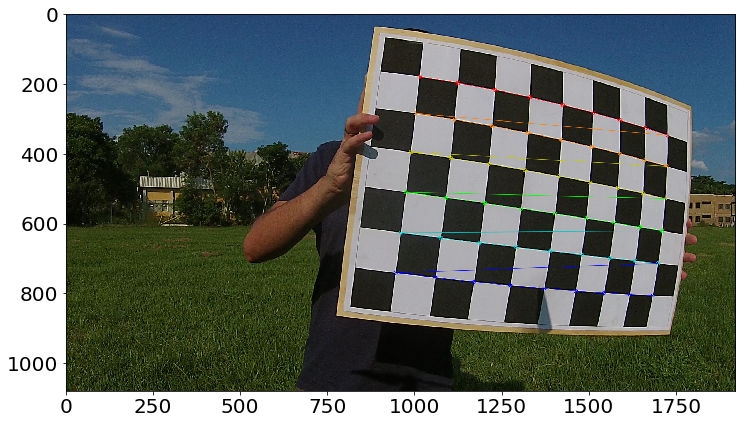

../data/frames_DJI00964/frame500.png


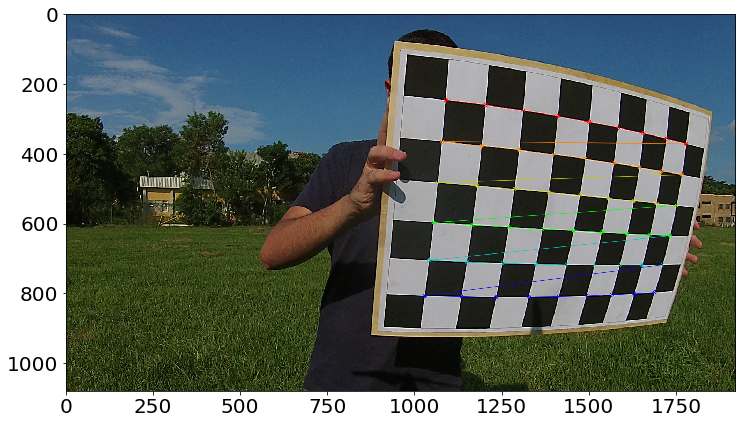

../data/frames_DJI00964/frame520.png


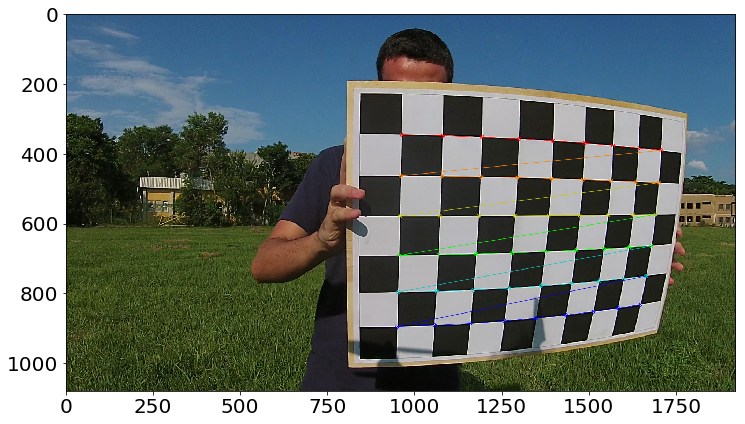

../data/frames_DJI00964/frame540.png


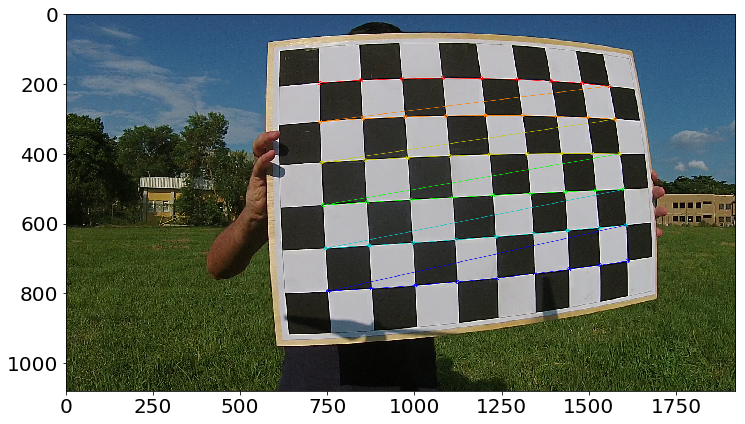

../data/frames_DJI00964/frame560.png


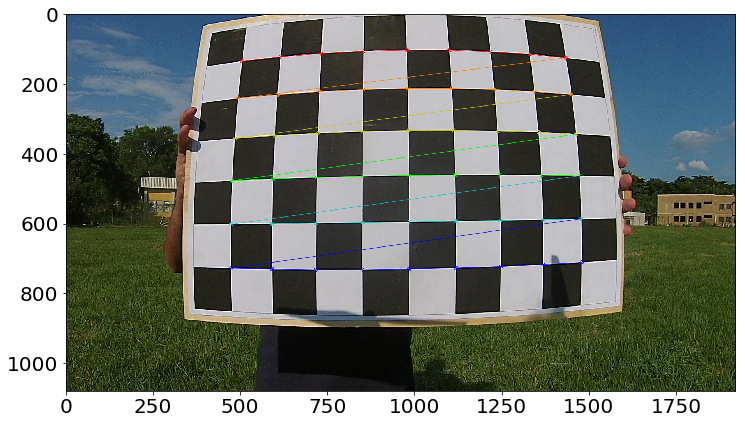

../data/frames_DJI00964/frame580.png


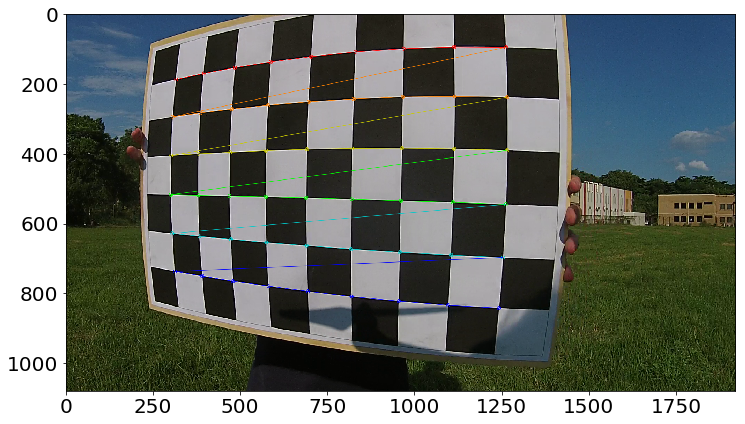

../data/frames_DJI00964/frame600.png


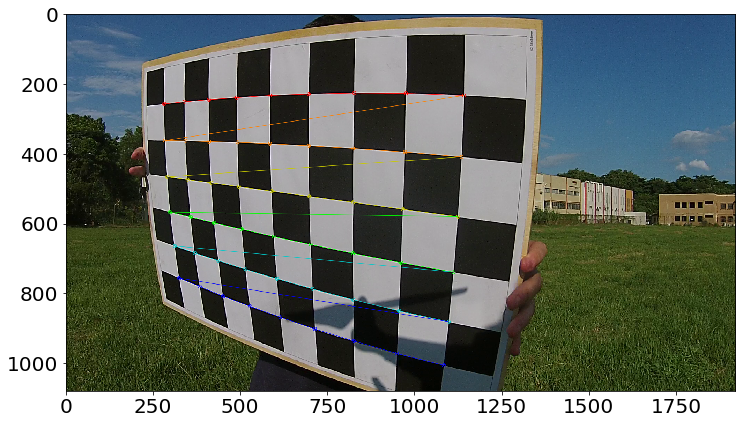

../data/frames_DJI00964/frame620.png
../data/frames_DJI00964/frame640.png


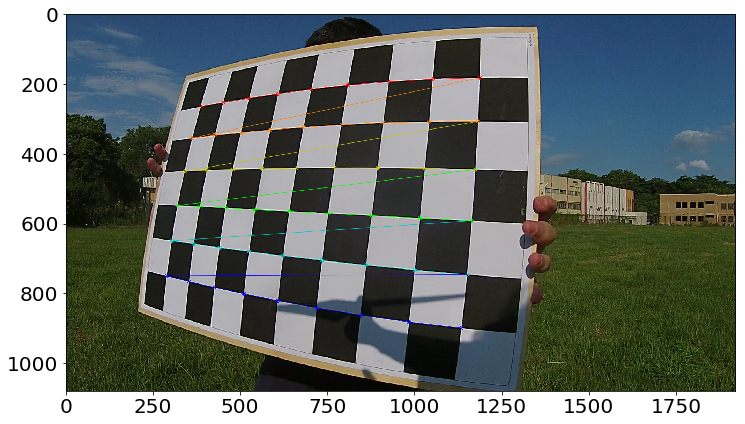

../data/frames_DJI00964/frame660.png


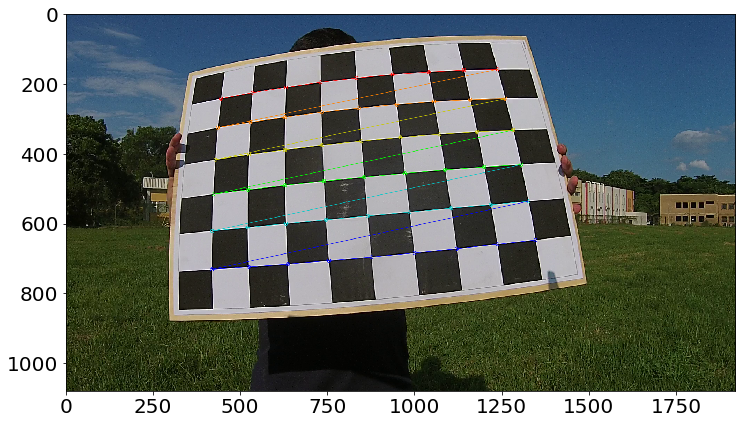

../data/frames_DJI00964/frame680.png


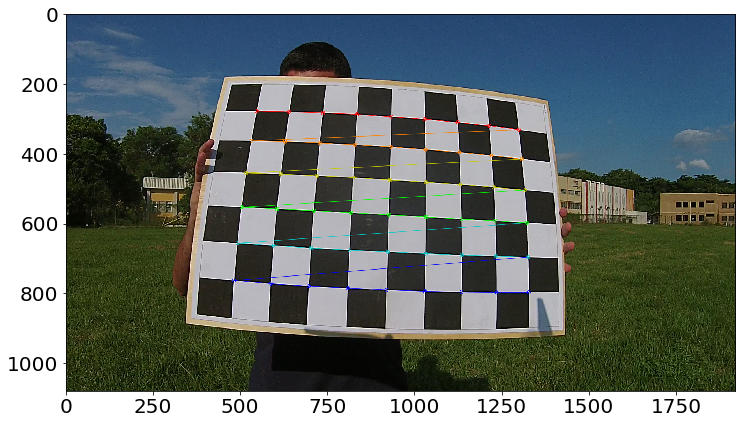

../data/frames_DJI00964/frame700.png


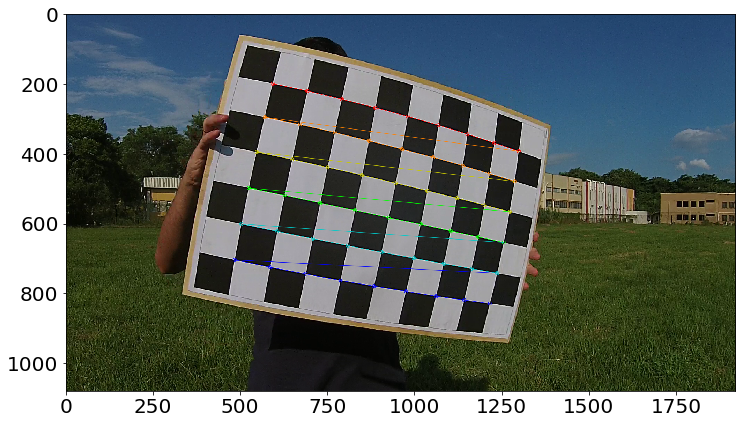

../data/frames_DJI00964/frame720.png
../data/frames_DJI00964/frame740.png
../data/frames_DJI00964/frame760.png


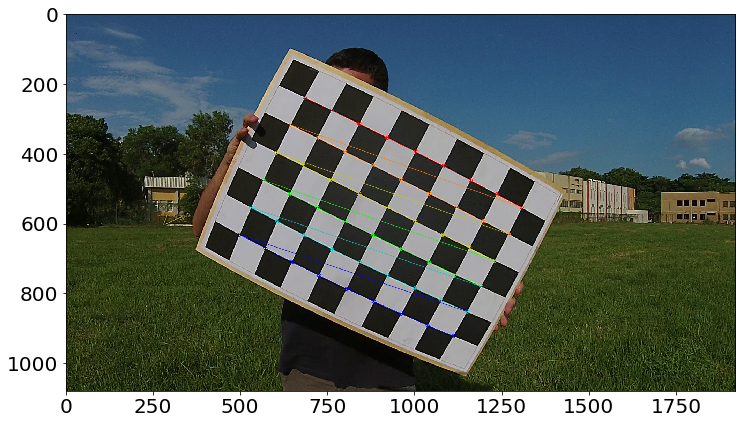

../data/frames_DJI00964/frame780.png


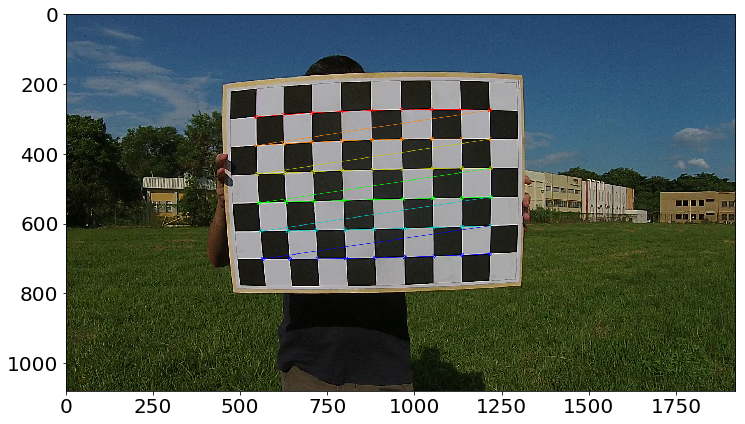

../data/frames_DJI00964/frame800.png


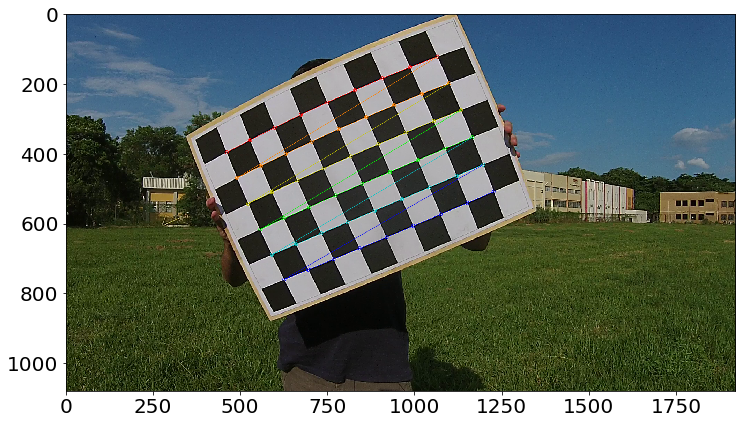

../data/frames_DJI00964/frame820.png


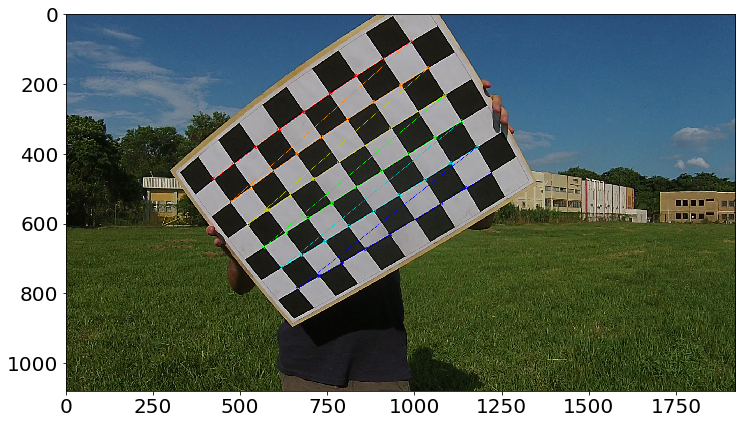

../data/frames_DJI00964/frame840.png


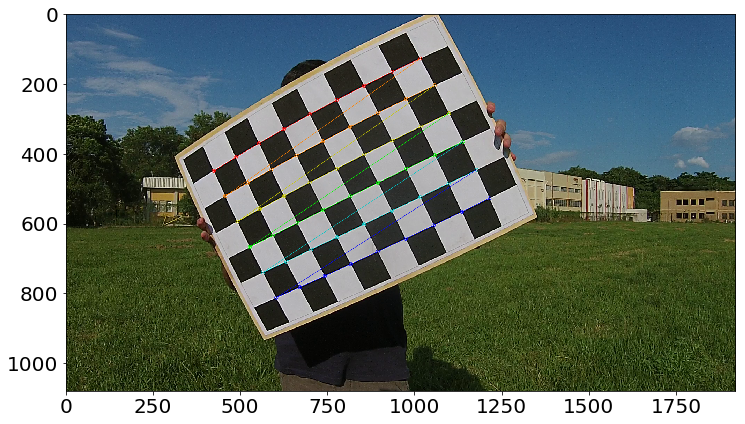

../data/frames_DJI00964/frame860.png


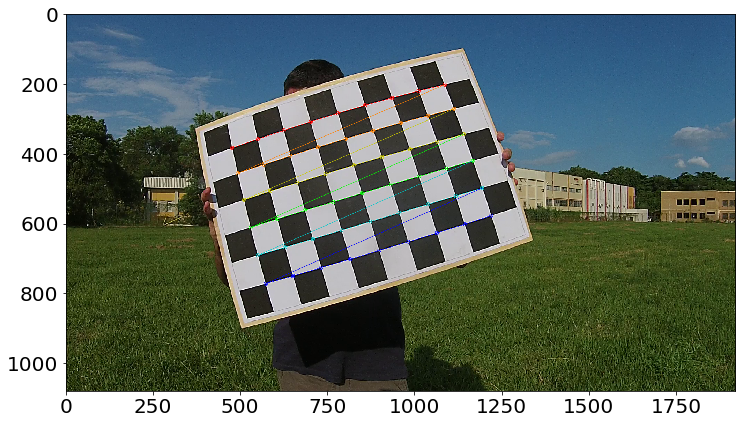

../data/frames_DJI00964/frame880.png


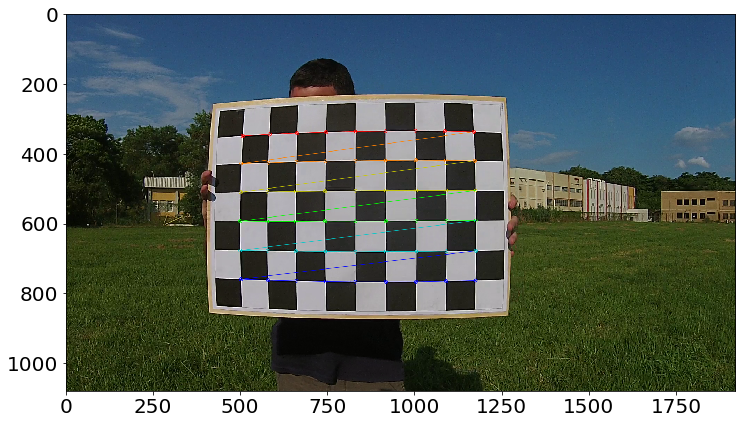

../data/frames_DJI00964/frame900.png


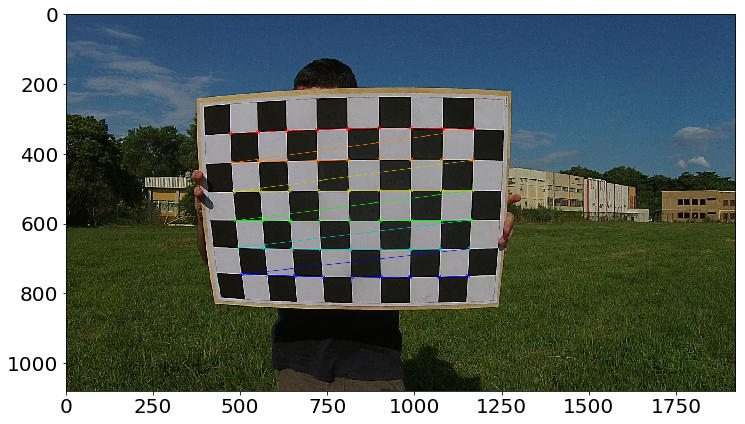

../data/frames_DJI00964/frame920.png


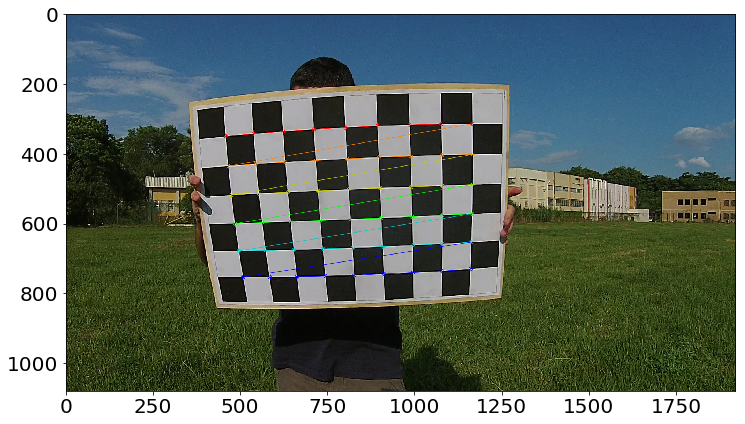

../data/frames_DJI00964/frame940.png


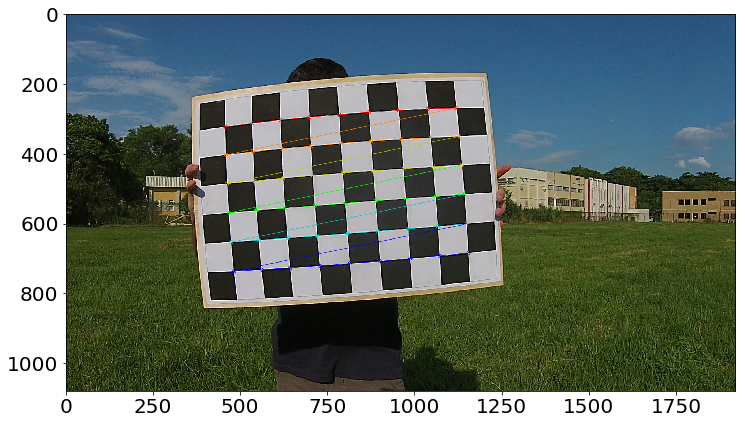

../data/frames_DJI00964/frame960.png


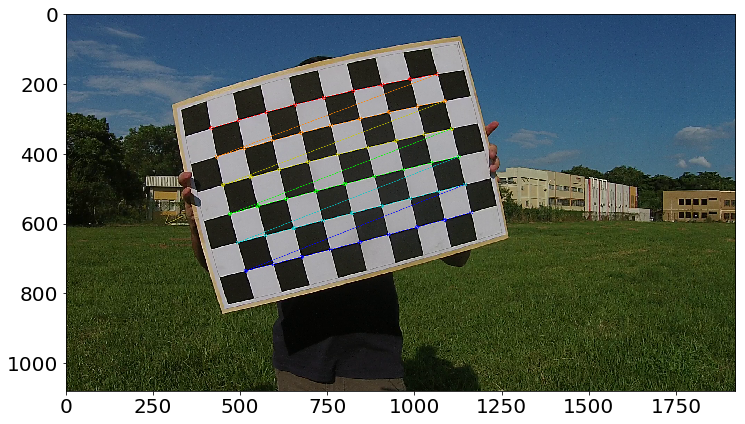

../data/frames_DJI00964/frame980.png


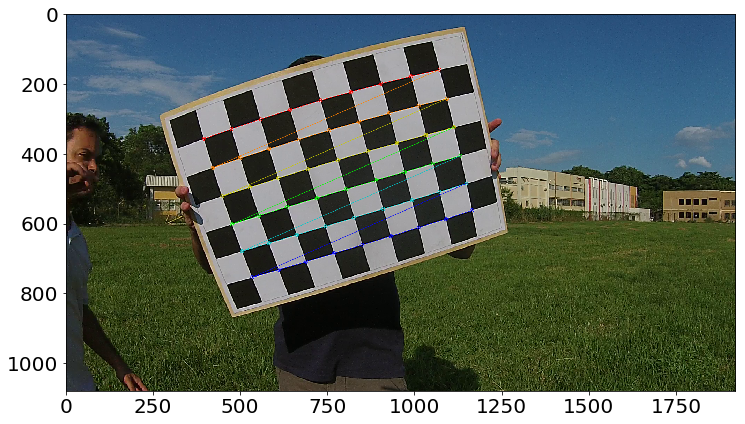

../data/frames_DJI00964/frame1000.png


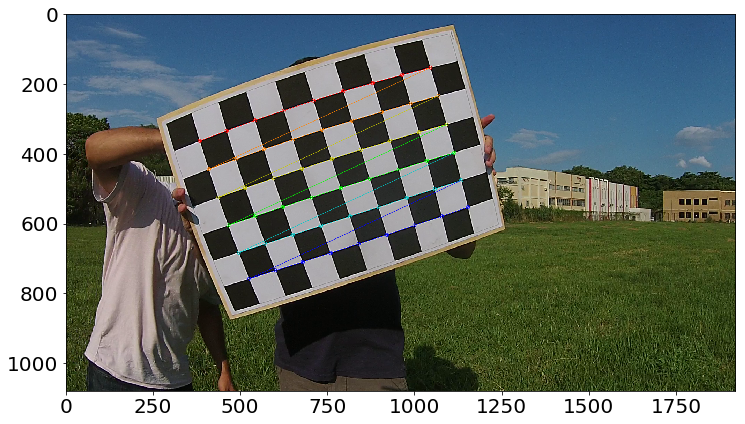

Failed to load: ../data/frames_DJI00964/frame1020.png


In [8]:
# Arrays to store object points and image points from all the images.
objpoints = [] # 3d point in real world space
imgpoints = [] # 2d points in image plane.

i = -1
#initilializing loop with a random numpy array
img = np.random.rand(3,2)
while img.any():
    
    i+=1
    
    img_name = images_path+'frame'+str(i*frame_step)+'.png'
    
    img = cv2.imread(img_name)
    
    if img is None:
        print('Failed to load: ' + img_name)        
        break
    
    print(img_name)
    
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)    
    
    # Find the chess board corners    
    ret, corners = cv2.findChessboardCorners(gray, pattern_size)

    # If found, add object points, image points (after refining them)
    if ret == True:
        
        cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
        
        objpoints.append(objp)        
        imgpoints.append(corners)
                
        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, pattern_size, corners,ret)
        plt.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))
        plt.show()        

## Camera Calibration
We use the function, cv2.calibrateCamera(). It returns the camera matrix, distortion coefficients, rotation and translation vectors etc.

In [9]:
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
print('camera matrix:\n')
print(mtx)
print('\n\ndistortion coefficients:\n')
print(dist)

camera matrix:

[[1.21348346e+03 0.00000000e+00 9.09769191e+02]
 [0.00000000e+00 1.20865532e+03 5.78786538e+02]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]


distortion coefficients:

[[-3.88785561e-01  2.10934314e-01 -2.50561693e-03 -4.54965873e-05
  -7.01193335e-02]]


## Re-projection Error

In [10]:
mean_error = 0
img_error = []
for i in range(len(objpoints)):
    imgpoints2, _ = cv2.projectPoints(objpoints[i], rvecs[i], tvecs[i], mtx, dist)
    error = cv2.norm(imgpoints[i], imgpoints2, cv2.NORM_L2)/len(imgpoints2)
    img_error.append(error)
    mean_error += error
mean_error/=len(objpoints)

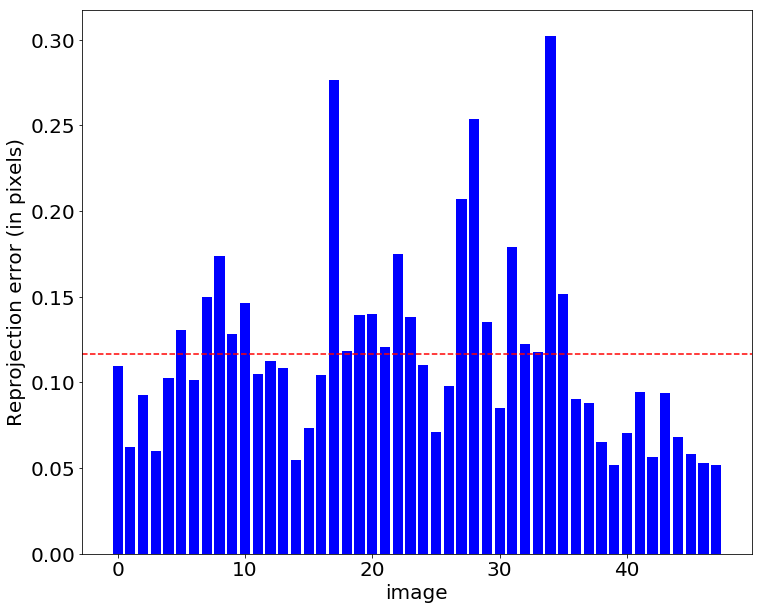

mean error: 0.11662504217011045


In [11]:
#plot reprojection error
plt.bar(list(range(i+1)), img_error, color="blue")
plt.axhline(y=mean_error, color='r', linestyle='--')
plt.xlabel('image',fontsize=20)
plt.ylabel('Reprojection error (in pixels)',fontsize=20)
plt.show()
print( "mean error: {}".format(mean_error) )

## Undistortion

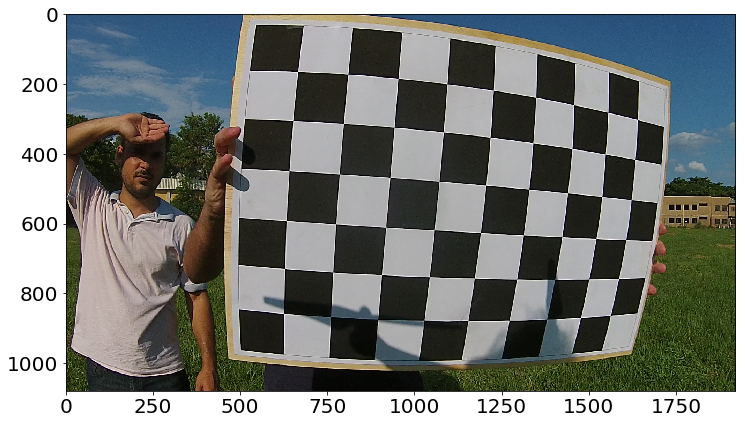

(1080, 1920, 3)


In [12]:
img =  cv2.imread('../data/frames_DJI00964/frame200.png')
h,  w = img.shape[:2]
#display image
plt.imshow(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))
plt.show() 
print(img.shape)

In [13]:
# newcameramtx, roi=cv2.getOptimalNewCameraMatrix(mtx, dist[:,:4], (w,h), 1, (w,h))
# print('camera matrix:\n')
# print(mtx)
# print('\n\n new camera matrix:\n')
# print(newcameramtx)
# print('\n\n roi:',roi)

* Using cv2.undistort()

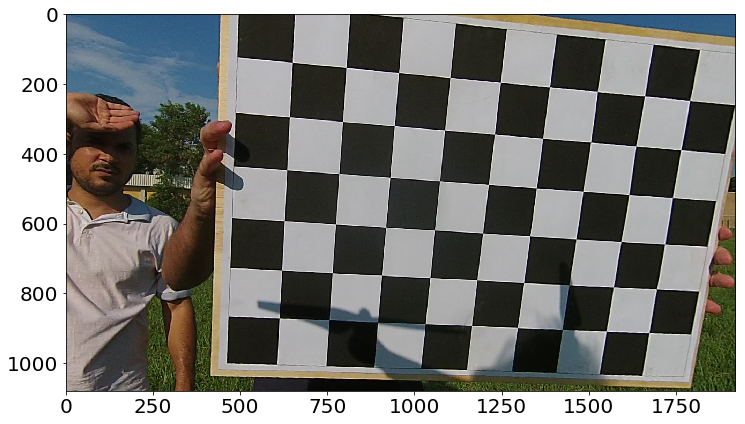

(1080, 1920, 3)


In [14]:
# undistort
#dst = cv2.undistort(img, mtx, dist[:,:4],newcameramtx)
dst = cv2.undistort(img, mtx, dist)

# crop the image
#x, y, w, h = roi
#dst = dst[y:y+h, x:x+w]
plt.imshow(cv2.cvtColor(dst,cv2.COLOR_BGR2RGB))
plt.show()
print(dst.shape)